# The Cancer Immune Cell Atlas

Aim of this notebook:  
1. Load data set  
2. Select cancer-type specific cells  
3. Identify cell-type specific marker genes  
4. Identify cell trajectories  
5. Run CellPhoneDB on the immune cell clusters to predict interactions  
6. Map the predictions onto the trajectory

### 1. Load data set

In [51]:
# import packages

import scanpy as sc
import squidpy as sq
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


In [2]:
# sc.logging.print_versions() # prints the used package versions
sc.set_figure_params(facecolor="white", figsize=(4, 4)) # defines the parameters of figure outputs
sc.settings.verbosity = 3 # verbosity 3 --> show warnings, info and hint messages

In [3]:
# read the adata file
cic_atlas = sc.read("../02_data/01_raw_data/immune_atlas_full_adata.h5ad")

Let's see if we can reproduce figure 1, panel A of the preprint. 

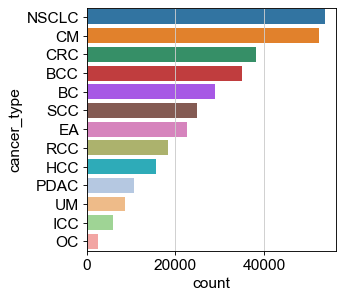

In [4]:
data = cic_atlas.obs['cancer_type'].to_frame()
sns.countplot(y='cancer_type', 
              data=data,
              order = data['cancer_type'].value_counts().index)

### 2. Select cancer-type specific cells

In [5]:
cic_atlas_bc = cic_atlas[cic_atlas.obs['cancer_type'] == "BC"]
print(cic_atlas_bc.obs["cancer_type"])
print(cic_atlas_bc)

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


X121270372023221_1_1_1_1    BC
X121270372579243_1_1_1_1    BC
X121270372616437_1_1_1_1    BC
X121270376229286_1_1_1_1    BC
X121270378085085_1_1_1_1    BC
                            ..
X66659992111835896_8_1      BC
X66659992115998048_8_1      BC
X66659992116083104_8_1      BC
X66659992116087592_8_1      BC
X66659992116095208_8_1      BC
Name: cancer_type, Length: 28918, dtype: category
Categories (1, object): ['BC']
View of AnnData object with n_obs × n_vars = 28918 × 87659
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'patient', 'percent.mt', 'gender', 'source', 'cancer_type', 'cluster_kmeans_k6', 'cell_type', 'cell_type_annotation', 'cancer_type_annotation'
    var: 'features'
    obsm: 'X_umap'


In [6]:
cic_atlas_crc = cic_atlas[cic_atlas.obs['cancer_type'] == "CRC"]
print(cic_atlas_crc.obs["cancer_type"])
print(cic_atlas_crc)

TGCTGCTGTAAGGATT_20_2    CRC
TGGACGCAGGCTAGCA_20_2    CRC
TGGACGCAGTTGAGAT_20_2    CRC
TGGACGCTCCAAATGC_20_2    CRC
TGGACGCTCTAAGCCA_20_2    CRC
                        ... 
TTTGTCAGTACCAGTT_2_8     CRC
TTTGTCAGTATTCGTG_2_8     CRC
TTTGTCAGTCAAACTC_2_8     CRC
TTTGTCAGTTTACTCT_2_8     CRC
TTTGTCATCTGTCTAT_2_8     CRC
Name: cancer_type, Length: 38276, dtype: category
Categories (1, object): ['CRC']
View of AnnData object with n_obs × n_vars = 38276 × 87659
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'patient', 'percent.mt', 'gender', 'source', 'cancer_type', 'cluster_kmeans_k6', 'cell_type', 'cell_type_annotation', 'cancer_type_annotation'
    var: 'features'
    obsm: 'X_umap'


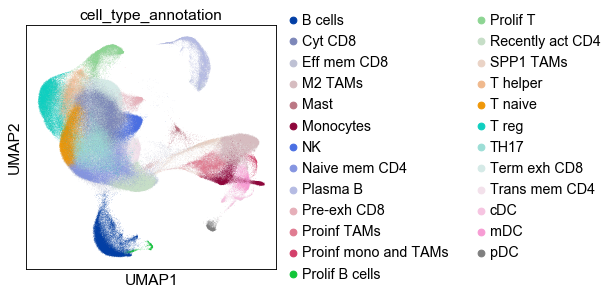

Trying to set attribute `.uns` of view, copying.


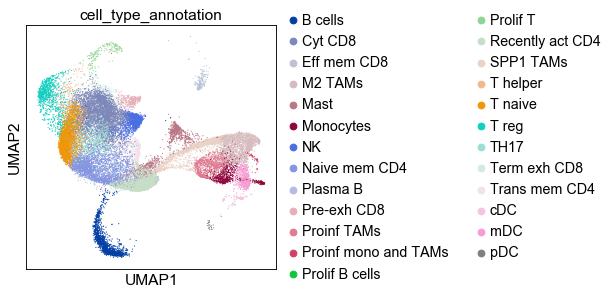

Trying to set attribute `.uns` of view, copying.


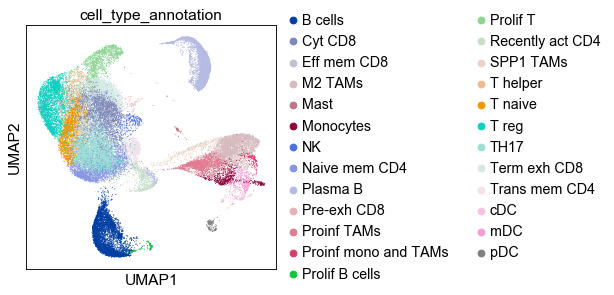

In [7]:
# compare umaps 
sc.pl.umap(cic_atlas, color=["cell_type_annotation"], wspace=0.4)
plt.show()

sc.pl.umap(cic_atlas_bc, color=["cell_type_annotation"], wspace=0.4)
plt.show()

sc.pl.umap(cic_atlas_crc, color=["cell_type_annotation"], wspace=0.4)
plt.show()

Compare cancer-type specific cell-type distributions.

In [8]:
cic_atlas_bc

AnnData object with n_obs × n_vars = 28918 × 87659
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'patient', 'percent.mt', 'gender', 'source', 'cancer_type', 'cluster_kmeans_k6', 'cell_type', 'cell_type_annotation', 'cancer_type_annotation'
    var: 'features'
    uns: 'cell_type_annotation_colors'
    obsm: 'X_umap'

In [21]:
cic_atlas_crc

AnnData object with n_obs × n_vars = 38276 × 87659
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'patient', 'percent.mt', 'gender', 'source', 'cancer_type', 'cluster_kmeans_k6', 'cell_type', 'cell_type_annotation', 'cancer_type_annotation'
    var: 'features'
    uns: 'cell_type_annotation_colors'
    obsm: 'X_umap'

### 6. Map cells onto trajectories

In [22]:
sc.tl.pca(cic_atlas_bc, svd_solver='arpack')
sc.tl.pca(cic_atlas_crc, svd_solver='arpack')

computing PCA
    with n_comps=50
    finished (0:00:17)
computing PCA
    with n_comps=50
    finished (0:01:08)


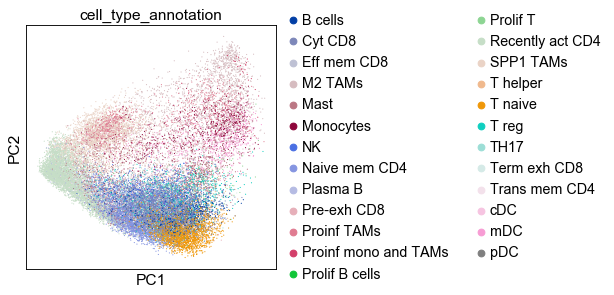

In [13]:
sc.pl.pca(cic_atlas_bc, color='cell_type_annotation')

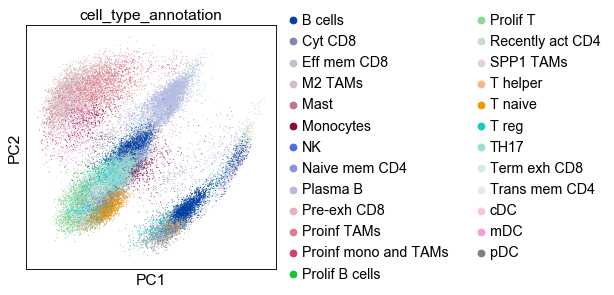

In [23]:
sc.pl.pca(cic_atlas_crc, color='cell_type_annotation')

In [15]:
sc.pp.neighbors(cic_atlas_bc, n_neighbors=4, n_pcs=20)
sc.tl.draw_graph(cic_atlas_bc)

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)
drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:03:45)


In [24]:
sc.pp.neighbors(cic_atlas_crc, n_neighbors=4, n_pcs=20)
sc.tl.draw_graph(cic_atlas_crc)

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:05:25)


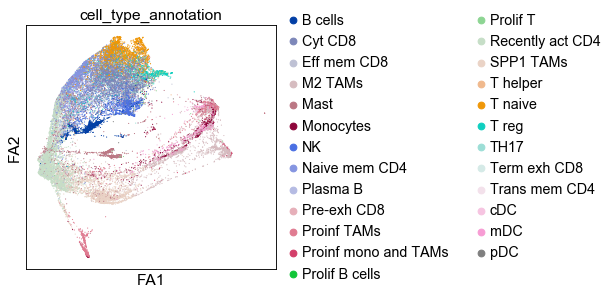

In [17]:
sc.pl.draw_graph(cic_atlas_bc, color='cell_type_annotation')

ok, so this does not make a lot of sense, because this is not a developmental process. We do not assume that the individiual cell types trasnition into each other. So to come up with a reasonable interpretation, we first have to select the individual cell types and then plot the trajectories.

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


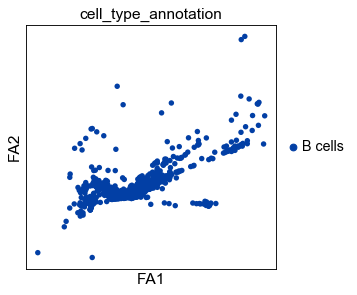

In [19]:
sc.pl.draw_graph(cic_atlas_bc[cic_atlas_bc.obs['cell_type_annotation'] == "B cells"], color='cell_type_annotation')

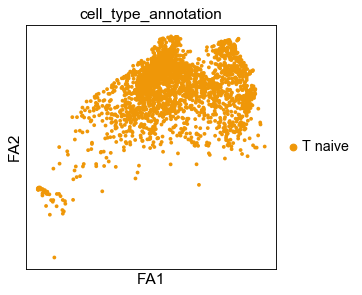

In [20]:
sc.pl.draw_graph(cic_atlas_bc[cic_atlas_bc.obs['cell_type_annotation'] == "T naive"], color='cell_type_annotation')

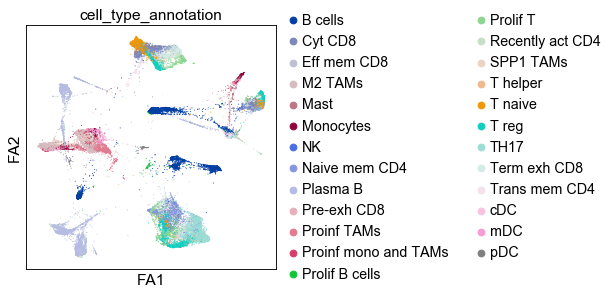

In [25]:
sc.pl.draw_graph(cic_atlas_crc, color='cell_type_annotation')

#### Select subsets first!

Obviously, the diffusion mapping does not work work if we include all kind of immune-subsets into the analysis. This makes sense biologically, as they are not developmentally connected. Instead, I should take the individual cell subsets.


In [37]:
# select Cyt CD8
cyto_cd8 = cic_atlas[cic_atlas.obs['cell_type_annotation']=='Cyt CD8']

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


computing PCA
    with n_comps=50
    finished (0:00:50)


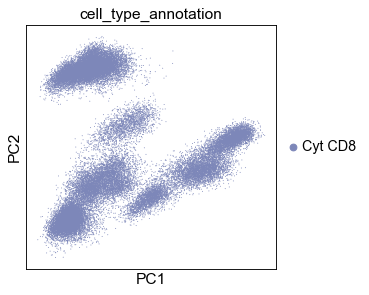

In [39]:
sc.tl.pca(cyto_cd8, svd_solver='arpack')
sc.pl.pca(cyto_cd8, color='cell_type_annotation')

In this PC plot we observe several clusters of cytotoxic CD8 T cells. Why? Is this an artefact or underlying biology? If so, which subtypes do these CD8 T cells represent?

In [41]:
sc.pp.neighbors(cyto_cd8, n_neighbors=4, n_pcs=20)
sc.tl.draw_graph(cyto_cd8)

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:05:25)


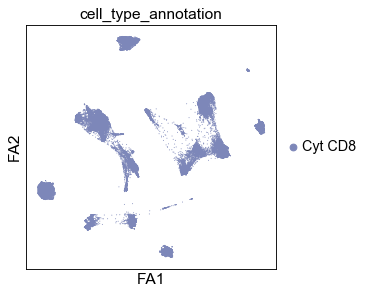

In [42]:
sc.pl.draw_graph(cyto_cd8, color='cell_type_annotation')

In [44]:
sc.tl.diffmap(cyto_cd8)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         1.         1.         1.         1.         1.
     1.         0.99991435 0.99885744 0.9985889  0.99838215 0.9971119
     0.9970904  0.9960529  0.9957706 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:03)


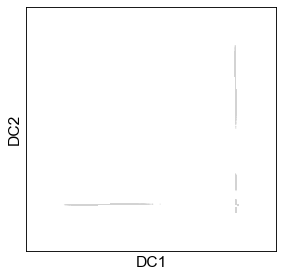

In [45]:
sc.pl.diffmap(cyto_cd8)

In [46]:
cyto_cd8

AnnData object with n_obs × n_vars = 40279 × 87659
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'patient', 'percent.mt', 'gender', 'source', 'cancer_type', 'cluster_kmeans_k6', 'cell_type', 'cell_type_annotation', 'cancer_type_annotation'
    var: 'features'
    uns: 'cell_type_annotation_colors', 'pca', 'neighbors', 'draw_graph', 'diffmap_evals'
    obsm: 'X_umap', 'X_pca', 'X_draw_graph_fa', 'X_diffmap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

### Cell.cell.interactions in CRC immune cell data

In [60]:
cic_atlas_crc.obs['cell_type_annotation']

TGCTGCTGTAAGGATT_20_2        Monocytes
TGGACGCAGGCTAGCA_20_2              mDC
TGGACGCAGTTGAGAT_20_2          M2 TAMs
TGGACGCTCCAAATGC_20_2          M2 TAMs
TGGACGCTCTAAGCCA_20_2          M2 TAMs
                             ...      
TTTGTCAGTACCAGTT_2_8     Trans mem CD4
TTTGTCAGTATTCGTG_2_8           Cyt CD8
TTTGTCAGTCAAACTC_2_8           B cells
TTTGTCAGTTTACTCT_2_8     Trans mem CD4
TTTGTCATCTGTCTAT_2_8           B cells
Name: cell_type_annotation, Length: 38276, dtype: category
Categories (25, object): ['B cells', 'Cyt CD8', 'Eff mem CD8', 'M2 TAMs', ..., 'Trans mem CD4', 'cDC', 'mDC', 'pDC']

In [52]:
cic_atlas_crc.raw = cic_atlas_crc
sq.gr.ligrec(cic_atlas_crc, cluster_key="cell_type_annotation", use_raw=False)

Fetching interactions from `omnipath`
/opt/anaconda3/lib/python3.7/site-packages/omnipath/_core/requests/_utils.py:155: FutureWarning: The default value of regex will change from True to False in a future version.
  _split_unique_join(data.str.replace(r"[-\w]*:?(\d+)", r"\1")), func=func
Fetched `8919` interactions
    Finish (0:00:03)
Running `1000` permutations on `3476` interactions and `625` cluster combinations using `1` core(s)


  0%|          | 0/1000 [00:00<?, ?permutation/s]

Adding `adata.uns['cell_type_annotation_ligrec']`
Finish (0:01:11)


In [53]:
# visualization
sq.pl.ligrec(
    cic_atlas_crc,
    cluster_key="cell_type_annotation",
    alpha = 0.0001
)

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


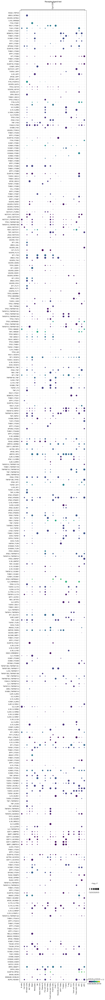

In [67]:
# visualization
sq.pl.ligrec(
    cic_atlas_crc,
    cluster_key="cell_type_annotation",
    alpha = 0.000001,
    source_groups='Cyt CD8'
)



In [71]:
cic_atlas_bc.raw = cic_atlas_bc
sq.gr.ligrec(cic_atlas_bc, 
             cluster_key="cell_type_annotation", 
             interactions_params={"resources": "CellPhoneDB"},
             use_raw=False)

Fetching interactions from `omnipath`


  0%|          | 0.00/427k [00:00<?, ?B/s]

/opt/anaconda3/lib/python3.7/site-packages/omnipath/_core/requests/_utils.py:155: FutureWarning: The default value of regex will change from True to False in a future version.
  _split_unique_join(data.str.replace(r"[-\w]*:?(\d+)", r"\1")), func=func
Fetched `968` interactions
    Finish (0:00:00)
Running `1000` permutations on `478` interactions and `625` cluster combinations using `1` core(s)


  0%|          | 0/1000 [00:00<?, ?permutation/s]

Adding `adata.uns['cell_type_annotation_ligrec']`
Finish (0:00:31)


/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Found `20` significant interactions at level `0.001`


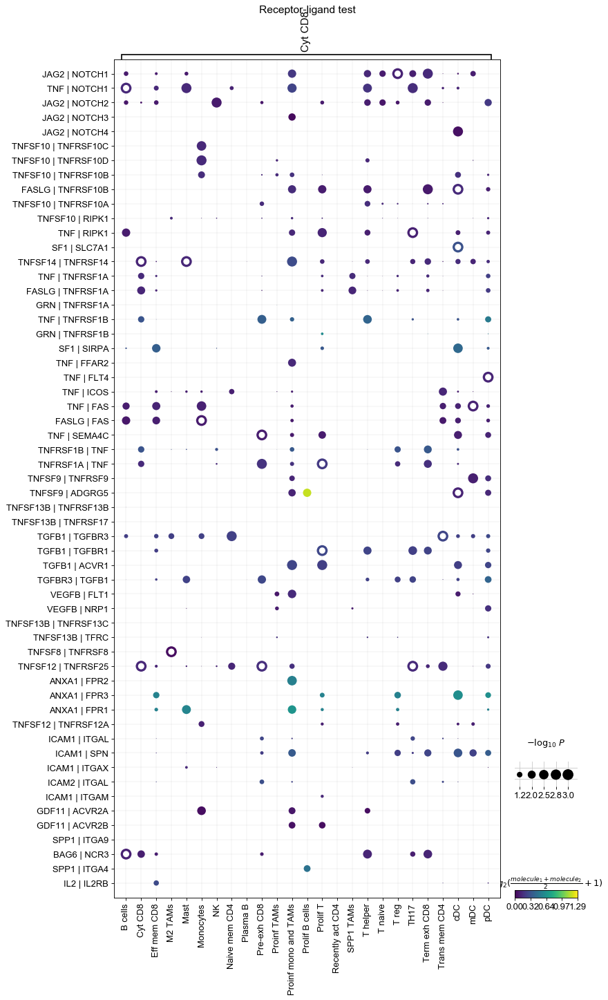

In [72]:
# visualization
sq.pl.ligrec(
    cic_atlas_bc,
    cluster_key="cell_type_annotation",
    alpha = 0.001,
    source_groups='Cyt CD8'
)


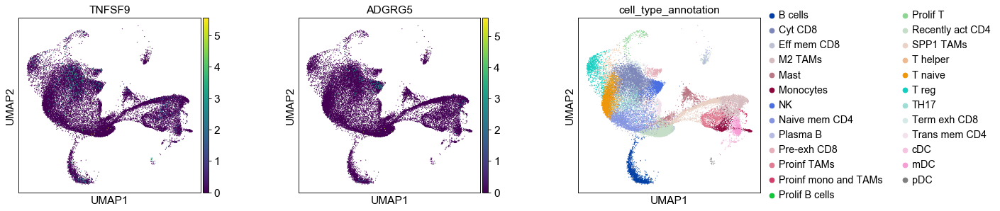

In [78]:
sc.pl.umap(cic_atlas_bc, color=["TNFSF9",  "ADGRG5", "cell_type_annotation"], wspace=0.4)
plt.show()
